In [ ]:
from kaggle.api.kaggle_api_extended import KaggleApi
import os

# 1. Set the download folder
download_path = "../data"

# 2. Create the folder if it doesn't exist
if not os.path.exists(download_path):
    os.makedirs(download_path)
    print(f"Created folder: {download_path}")
else:
    print(f"Folder already exists: {download_path}")

# 3. Initialize and authenticate Kaggle API
api = KaggleApi()
api.authenticate()

# 4. Dataset name on Kaggle
dataset_name = "bhavikjikadara/dog-and-cat-classification-dataset"

# 5. Download and unzip the dataset
api.dataset_download_files(
    dataset_name,
    path=download_path,
    unzip=True
)
print("Download completed. Dataset is in:", os.path.abspath(download_path))


In [9]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from sklearn.metrics import classification_report
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_curve, auc
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau

In [9]:
DATA_DIR = "../data"

for split in ["train", "val", "test"]:
    print(f"\n📁 {split.upper()} DATASET")
    split_path = os.path.join(DATA_DIR, split)
    for cls in os.listdir(split_path):
        cls_path = os.path.join(split_path, cls)
        count = len(os.listdir(cls_path))
        print(f"  {cls}: {count} images")



📁 TRAIN DATASET
  0: 10000 images
  1: 9999 images

📁 VAL DATASET
  0: 1250 images
  1: 1250 images

📁 TEST DATASET
  0: 1250 images
  1: 1250 images


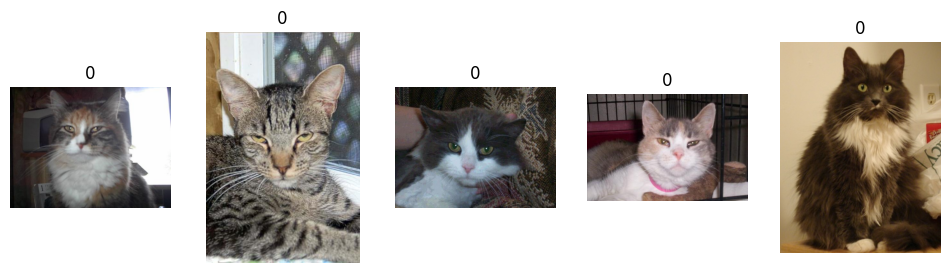

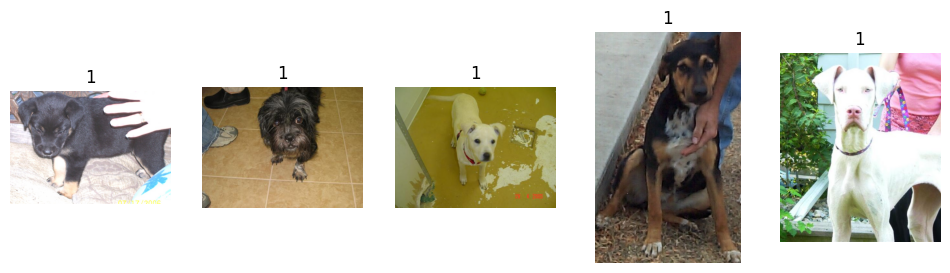

In [10]:
def show_samples(split="train", cls="cat", num=5):
    path = os.path.join(DATA_DIR, split, cls)
    imgs = random.sample(os.listdir(path), num)
    
    plt.figure(figsize=(12,3))
    for i, img in enumerate(imgs):
        img_path = os.path.join(path, img)
        image = mpimg.imread(img_path)
        plt.subplot(1, num, i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(cls)
    plt.show()

# Example usage:
show_samples("train", "0")
show_samples("train", "1")

In [ ]:
os.makedirs('data/resized_imgs', exist_ok=True)

original_dirs = ['data/train', 'data/val', 'data/test']
# Folder to save resized images
resized_base_dir = 'data/resized_imgs'
target_size = (224, 224)

In [ ]:
for original_dir in original_dirs:
    split_name = os.path.basename(original_dir)  # train / val / test
    resized_dir = os.path.join(resized_base_dir, split_name)

    # Loop over classes (cat/dog)
    for cls in os.listdir(original_dir):
        class_path = os.path.join(original_dir, cls)
        save_class_path = os.path.join(resized_dir, cls)
        os.makedirs(save_class_path, exist_ok=True)

        # Loop over images
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            try:
                img = Image.open(img_path)
                # Convert to RGB if not already
                if img.mode != 'RGB':
                    img = img.convert('RGB')
                img = img.resize(target_size)
                save_path = os.path.join(save_class_path, img_name)
                img.save(save_path)
            except Exception as e:
                print(f"Error processing {img_path}: {e}")

print("✅ All train, val, test images resized and saved successfully.")

In [12]:
image_dir = "../data/resized_imgs"

for split in ["train", "val", "test"]:
    print(f"\n📁 {split.upper()} DATASET")
    split_path = os.path.join(image_dir, split)
    for cls in os.listdir(split_path):
        cls_path = os.path.join(split_path, cls)
        count = len(os.listdir(cls_path))
        print(f"  {cls}: {count} images")



📁 TRAIN DATASET
  0: 10000 images
  1: 9999 images

📁 VAL DATASET
  0: 1250 images
  1: 1250 images

📁 TEST DATASET
  0: 1250 images
  1: 1250 images


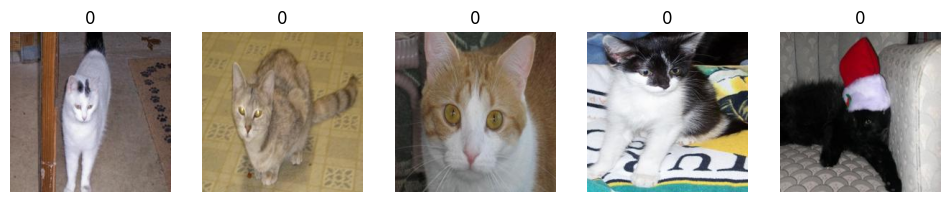

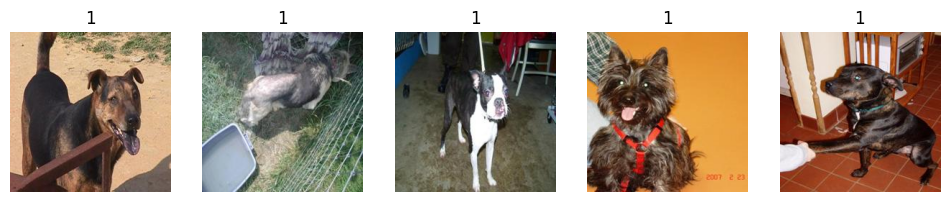

In [13]:
DATA_DIR = "../data/resized_imgs"

def show_samples(split="train", cls="cat", num=5):
    path = os.path.join(DATA_DIR, split, cls)
    imgs = random.sample(os.listdir(path), num)
    
    plt.figure(figsize=(12,3))
    for i, img in enumerate(imgs):
        img_path = os.path.join(path, img)
        image = mpimg.imread(img_path)
        plt.subplot(1, num, i+1)
        plt.imshow(image)
        plt.axis('off')
        plt.title(cls)
    plt.show()

# Example usage:
show_samples("train", "0")
show_samples("train", "1")

In [14]:
DATA_DIR = "data/resized_imgs"
TARGET_SIZE = (224, 224)
BATCH_SIZE = 32

In [2]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

train_data = train_datagen.flow_from_directory(
    '../data/resized_imgs/train', 
    target_size=(224,224), 
    batch_size=32, 
    class_mode='binary'
)
val_data = val_datagen.flow_from_directory(
    '../data/resized_imgs/val', 
    target_size=(224,224), 
    batch_size=32, 
    class_mode='binary'
)
test_data = test_datagen.flow_from_directory(
    '../data/resized_imgs/test', 
    target_size=(224,224), 
    batch_size=32, 
    class_mode='binary', 
    shuffle=False
)


Found 19999 images belonging to 2 classes.
Found 2500 images belonging to 2 classes.
Found 2500 images belonging to 2 classes.


In [22]:
base_model = MobileNetV2(
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet'
)

In [23]:
# Freeze convolutional base (don’t train)
base_model.trainable = False

In [24]:
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.BatchNormalization(),
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.3),
    layers.Dense(1, activation='sigmoid')
])

In [25]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(
    optimizer=optimizer,
    loss='binary_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │       327,936 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,591,297 (9.89 MB)

 Trainable params: 330,753 (1.26 MB)

 Non-trainable params: 2,260,544 (8.62 MB)

In [26]:
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    ModelCheckpoint('best_mobilenet_model.h5', save_best_only=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1)
]

In [27]:
# 5️⃣ Train Base Model
EPOCHS_BASE = 15
history = model.fit(
    train_data,
    validation_data=val_data,
    epochs=EPOCHS_BASE,
    callbacks=callbacks
)

Epoch 1/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9116 - loss: 0.2078

625/625 ━━━━━━━━━━━━━━━━━━━━ 965s 2s/step - accuracy: 0.9457 - loss: 0.1355 - val_accuracy: 0.9784 - val_loss: 0.0491 - learning_rate: 1.0000e-04
Epoch 2/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 912ms/step - accuracy: 0.9613 - loss: 0.0955

625/625 ━━━━━━━━━━━━━━━━━━━━ 644s 987ms/step - accuracy: 0.9626 - loss: 0.0951 - val_accuracy: 0.9816 - val_loss: 0.0422 - learning_rate: 1.0000e-04
Epoch 3/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 26s/step - accuracy: 0.9680 - loss: 0.0834 

625/625 ━━━━━━━━━━━━━━━━━━━━ 16566s 27s/step - accuracy: 0.9677 - loss: 0.0828 - val_accuracy: 0.9832 - val_loss: 0.0393 - learning_rate: 1.0000e-04
Epoch 4/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 847s 1s/step - accuracy: 0.9694 - loss: 0.0765 - val_accuracy: 0.9836 - val_loss: 0.0406 - learning_rate: 1.0000e-04
Epoch 5/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 893ms/step - accuracy: 0.9702 - loss: 0.0728

625/625 ━━━━━━━━━━━━━━━━━━━━ 605s 968ms/step - accuracy: 0.9703 - loss: 0.0730 - val_accuracy: 0.9860 - val_loss: 0.0374 - learning_rate: 1.0000e-04
Epoch 6/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 707ms/step - accuracy: 0.9728 - loss: 0.0716

625/625 ━━━━━━━━━━━━━━━━━━━━ 489s 782ms/step - accuracy: 0.9737 - loss: 0.0682 - val_accuracy: 0.9848 - val_loss: 0.0353 - learning_rate: 1.0000e-04
Epoch 7/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 607s 972ms/step - accuracy: 0.9738 - loss: 0.0666 - val_accuracy: 0.9836 - val_loss: 0.0369 - learning_rate: 1.0000e-04
Epoch 8/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 33011s 53s/step - accuracy: 0.9763 - loss: 0.0602 - val_accuracy: 0.9844 - val_loss: 0.0368 - learning_rate: 1.0000e-04
Epoch 9/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 794ms/step - accuracy: 0.9781 - loss: 0.0588
Epoch 9: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-05.
625/625 ━━━━━━━━━━━━━━━━━━━━ 565s 867ms/step - accuracy: 0.9774 - loss: 0.0581 - val_accuracy: 0.9848 - val_loss: 0.0368 - learning_rate: 1.0000e-04
Epoch 10/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 890ms/step - accuracy: 0.9778 - loss: 0.0563

625/625 ━━━━━━━━━━━━━━━━━━━━ 602s 963ms/step - accuracy: 0.9771 - loss: 0.0576 - val_accuracy: 0.9848 - val_loss: 0.0343 - learning_rate: 5.0000e-05
Epoch 11/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 610s 976ms/step - accuracy: 0.9770 - loss: 0.0598 - val_accuracy: 0.9848 - val_loss: 0.0349 - learning_rate: 5.0000e-05
Epoch 12/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 425s 680ms/step - accuracy: 0.9779 - loss: 0.0562 - val_accuracy: 0.9856 - val_loss: 0.0352 - learning_rate: 5.0000e-05
Epoch 13/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9800 - loss: 0.0502
Epoch 13: ReduceLROnPlateau reducing learning rate to 2.499999936844688e-05.
625/625 ━━━━━━━━━━━━━━━━━━━━ 877s 1s/step - accuracy: 0.9783 - loss: 0.0551 - val_accuracy: 0.9864 - val_loss: 0.0348 - learning_rate: 5.0000e-05
Epoch 14/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 725ms/step - accuracy: 0.9824 - loss: 0.0500

625/625 ━━━━━━━━━━━━━━━━━━━━ 491s 785ms/step - accuracy: 0.9816 - loss: 0.0519 - val_accuracy: 0.9860 - val_loss: 0.0336 - learning_rate: 2.5000e-05
Epoch 15/15
625/625 ━━━━━━━━━━━━━━━━━━━━ 422s 675ms/step - accuracy: 0.9786 - loss: 0.0542 - val_accuracy: 0.9860 - val_loss: 0.0340 - learning_rate: 2.5000e-05


In [ ]:
# Fine-tuning

# Unfreeze last 50 layers for fine-tuning
base_model.trainable = True
for layer in base_model.layers[:-50]:
    layer.trainable = False

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss='binary_crossentropy',
    metrics=['accuracy']
)

In [29]:
EPOCHS_FINE = 10
history_fine = model.fit(
    train_data,
    validation_data=val_data,
    epochs=EPOCHS_FINE,
    callbacks=callbacks
)

Epoch 1/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 1580s 3s/step - accuracy: 0.9554 - loss: 0.1102 - val_accuracy: 0.9836 - val_loss: 0.0432 - learning_rate: 1.0000e-05
Epoch 2/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 799s 1s/step - accuracy: 0.9640 - loss: 0.0893 - val_accuracy: 0.9836 - val_loss: 0.0353 - learning_rate: 1.0000e-05
Epoch 3/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9682 - loss: 0.0789

625/625 ━━━━━━━━━━━━━━━━━━━━ 952s 2s/step - accuracy: 0.9689 - loss: 0.0775 - val_accuracy: 0.9872 - val_loss: 0.0308 - learning_rate: 1.0000e-05
Epoch 4/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 898s 1s/step - accuracy: 0.9743 - loss: 0.0662 - val_accuracy: 0.9872 - val_loss: 0.0328 - learning_rate: 1.0000e-05
Epoch 5/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 917ms/step - accuracy: 0.9785 - loss: 0.0571

625/625 ━━━━━━━━━━━━━━━━━━━━ 611s 977ms/step - accuracy: 0.9782 - loss: 0.0576 - val_accuracy: 0.9876 - val_loss: 0.0289 - learning_rate: 1.0000e-05
Epoch 6/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 667s 1s/step - accuracy: 0.9785 - loss: 0.0536 - val_accuracy: 0.9884 - val_loss: 0.0297 - learning_rate: 1.0000e-05
Epoch 7/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9794 - loss: 0.0529

625/625 ━━━━━━━━━━━━━━━━━━━━ 700s 1s/step - accuracy: 0.9797 - loss: 0.0519 - val_accuracy: 0.9900 - val_loss: 0.0274 - learning_rate: 1.0000e-05
Epoch 8/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 668s 1s/step - accuracy: 0.9820 - loss: 0.0476 - val_accuracy: 0.9904 - val_loss: 0.0282 - learning_rate: 1.0000e-05
Epoch 9/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 663s 1s/step - accuracy: 0.9815 - loss: 0.0475 - val_accuracy: 0.9904 - val_loss: 0.0280 - learning_rate: 1.0000e-05
Epoch 10/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9842 - loss: 0.0387
Epoch 10: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-06.
625/625 ━━━━━━━━━━━━━━━━━━━━ 674s 1s/step - accuracy: 0.9835 - loss: 0.0410 - val_accuracy: 0.9880 - val_loss: 0.0313 - learning_rate: 1.0000e-05


In [ ]:
# Evaluate on Test Set
test_loss, test_acc = model.evaluate(test_data)
print(f"\n✅ Final Test Accuracy: {test_acc:.4f}")

79/79 ━━━━━━━━━━━━━━━━━━━━ 78s 993ms/step - accuracy: 0.9904 - loss: 0.0293

✅ Final Test Accuracy: 0.9904


Text(0.5, 1.0, 'Accuracy')

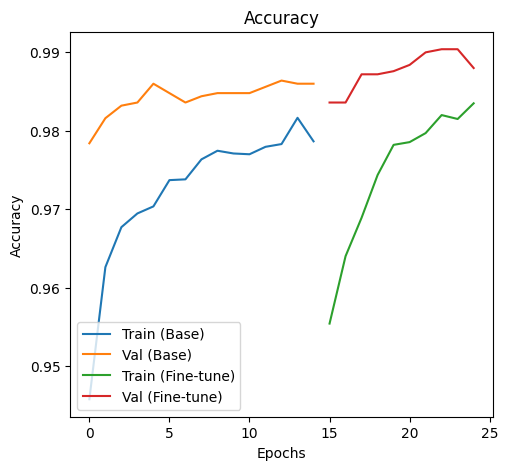

In [ ]:
# 8️⃣ Plot Accuracy & Loss
plt.figure(figsize=(12,5))
# Accuracy
plt.subplot(1,2,1)
plt.plot(history.history['accuracy'], label='Train (Base)')
plt.plot(history.history['val_accuracy'], label='Val (Base)')
plt.plot(range(len(history.history['accuracy']),
               len(history.history['accuracy'])+len(history_fine.history['accuracy'])),
         history_fine.history['accuracy'], label='Train (Fine-tune)')
plt.plot(range(len(history.history['accuracy']),
               len(history.history['accuracy'])+len(history_fine.history['val_accuracy'])),
         history_fine.history['val_accuracy'], label='Val (Fine-tune)')
plt.xlabel('Epochs'); plt.ylabel('Accuracy'); plt.legend(); plt.title('Accuracy')

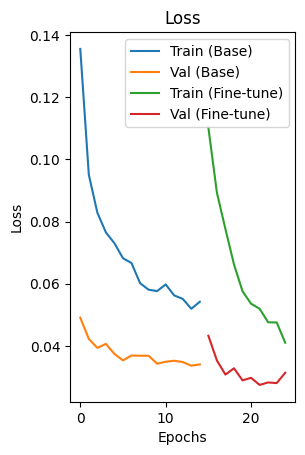

In [32]:
# Loss
plt.subplot(1,2,2)
plt.plot(history.history['loss'], label='Train (Base)')
plt.plot(history.history['val_loss'], label='Val (Base)')
plt.plot(range(len(history.history['loss']),
               len(history.history['loss'])+len(history_fine.history['loss'])),
         history_fine.history['loss'], label='Train (Fine-tune)')
plt.plot(range(len(history.history['loss']),
               len(history.history['loss'])+len(history_fine.history['val_loss'])),
         history_fine.history['val_loss'], label='Val (Fine-tune)')
plt.xlabel('Epochs'); plt.ylabel('Loss'); plt.legend(); plt.title('Loss')
plt.show()

In [33]:
# Save entire model (architecture + weights + optimizer state)
model.save("mobilenetv2_cat_dog.h5")
print("✅ Model saved successfully.")
model.save("mobilenetv2_cat_dog.keras")
print("✅ Model saved successfully.")

✅ Model saved successfully.
✅ Model saved successfully.


In [3]:
# Load saved model
loaded_model = load_model("../model/best_mobilenet_model.h5")
print("✅ Model loaded successfully.")

# Check summary to confirm
loaded_model.summary()

✅ Model loaded successfully.


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │       327,936 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,591,299 (9.89 MB)

 Trainable params: 2,185,857 (8.34 MB)

 Non-trainable params: 405,440 (1.55 MB)

 Optimizer params: 2 (12.00 B)

In [4]:
# 7️⃣ Evaluate on Test Set
test_loss, test_acc = loaded_model.evaluate(test_data)
print(f"\n✅ Final Test Accuracy: {test_acc:.4f}")

79/79 ━━━━━━━━━━━━━━━━━━━━ 54s 652ms/step - accuracy: 0.9904 - loss: 0.0293

✅ Final Test Accuracy: 0.9904


79/79 ━━━━━━━━━━━━━━━━━━━━ 32s 397ms/step


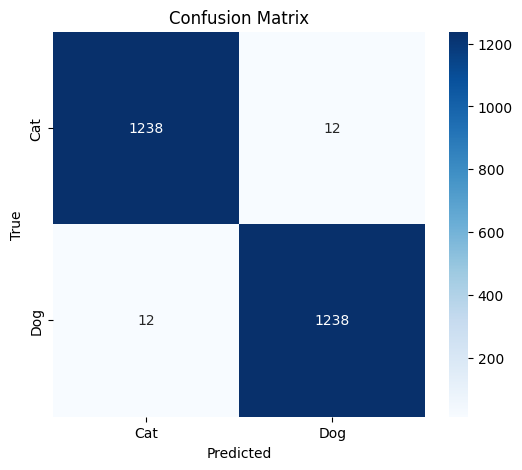

In [8]:
# Get true labels
y_true = test_data.classes

# Predict
y_pred = loaded_model.predict(test_data)
y_pred = (y_pred > 0.5).astype(int)

cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Cat', 'Dog'],
            yticklabels=['Cat', 'Dog'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [10]:
print(classification_report(y_true, y_pred, target_names=['Cat', 'Dog']))

              precision    recall  f1-score   support

         Cat       0.99      0.99      0.99      1250
         Dog       0.99      0.99      0.99      1250

    accuracy                           0.99      2500
   macro avg       0.99      0.99      0.99      2500
weighted avg       0.99      0.99      0.99      2500



79/79 ━━━━━━━━━━━━━━━━━━━━ 29s 360ms/step


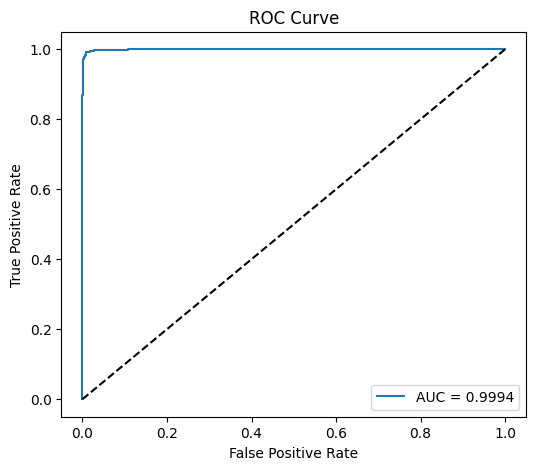

In [12]:
y_prob = loaded_model.predict(test_data)

fpr, tpr, thresholds = roc_curve(y_true, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(6,5))
plt.plot(fpr, tpr, label='AUC = %.4f' % roc_auc)
plt.plot([0,1], [0,1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()


🔍 Running predictions on TEST folder…
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


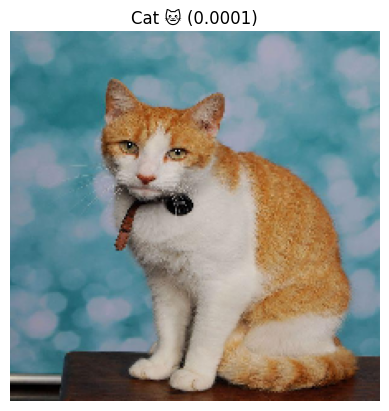

Image: cat_1.jpg
Prediction: Cat 🐱, Confidence: 0.0001

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


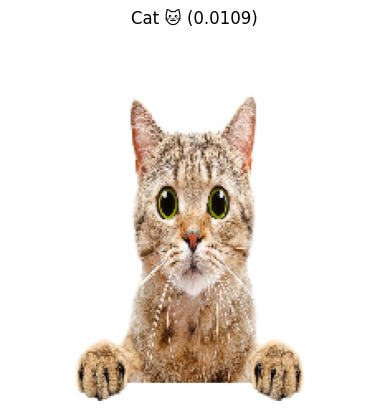

Image: cat_106.jpg
Prediction: Cat 🐱, Confidence: 0.0109

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


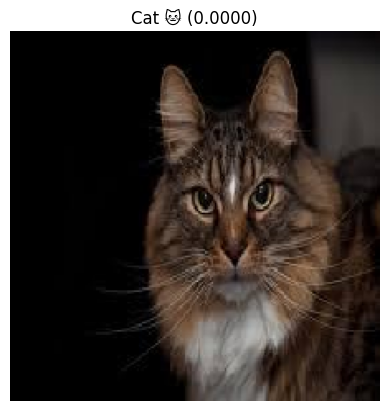

Image: cat_109.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


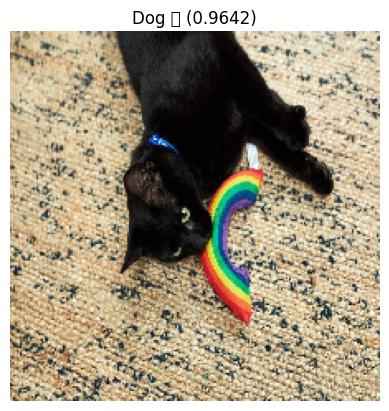

Image: cat_113.jpg
Prediction: Dog 🐶, Confidence: 0.9642

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


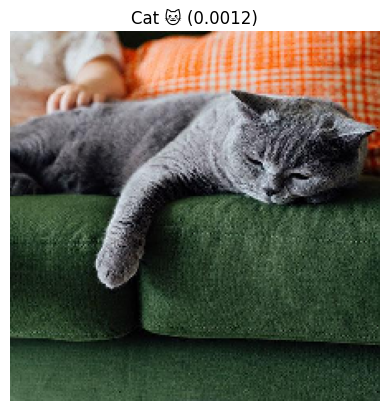

Image: cat_114.jpg
Prediction: Cat 🐱, Confidence: 0.0012

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


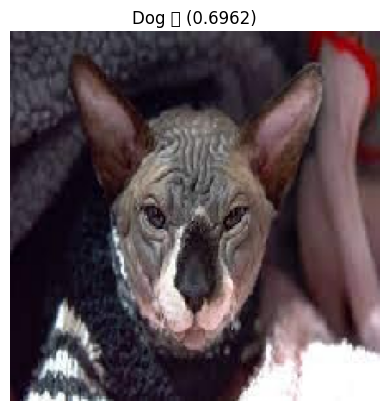

Image: cat_116.jpg
Prediction: Dog 🐶, Confidence: 0.6962

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


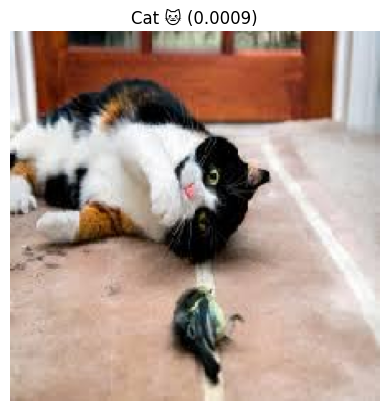

Image: cat_118.jpg
Prediction: Cat 🐱, Confidence: 0.0009

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


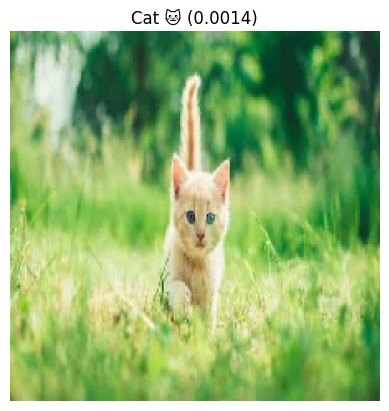

Image: cat_119.jpg
Prediction: Cat 🐱, Confidence: 0.0014

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


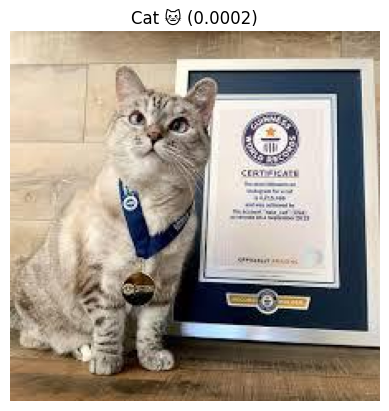

Image: cat_124.jpg
Prediction: Cat 🐱, Confidence: 0.0002

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


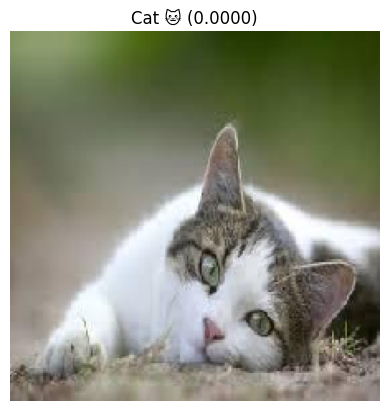

Image: cat_140.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


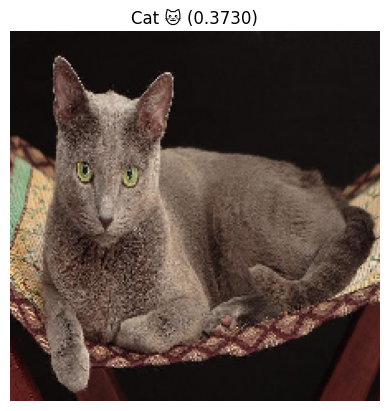

Image: cat_147.jpg
Prediction: Cat 🐱, Confidence: 0.3730

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


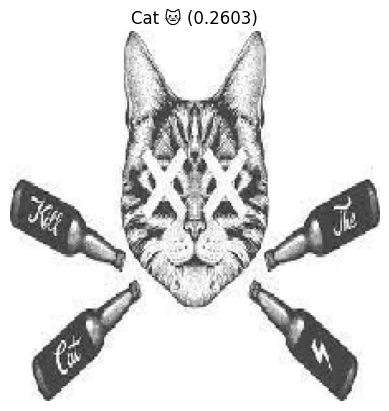

Image: cat_156.jpg
Prediction: Cat 🐱, Confidence: 0.2603

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


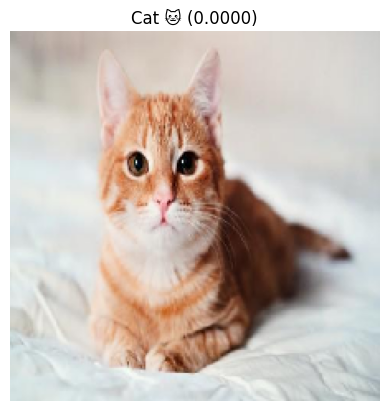

Image: cat_158.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


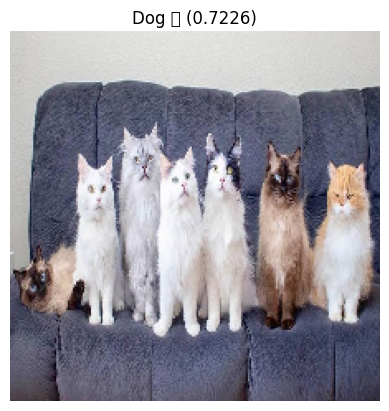

Image: cat_162.jpg
Prediction: Dog 🐶, Confidence: 0.7226

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


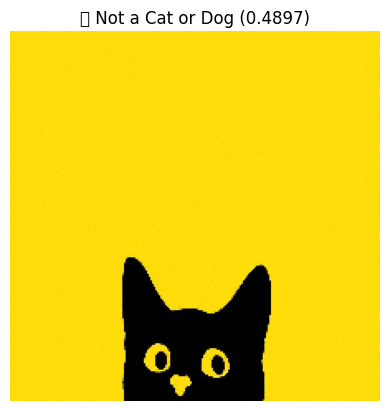

Image: cat_18.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4897

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


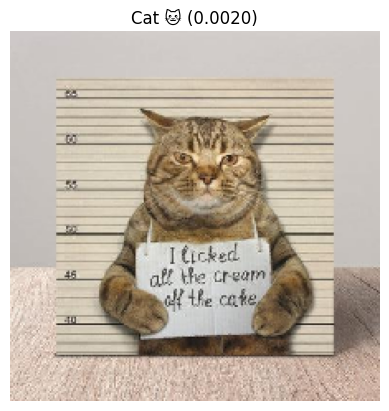

Image: cat_190.jpg
Prediction: Cat 🐱, Confidence: 0.0020

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


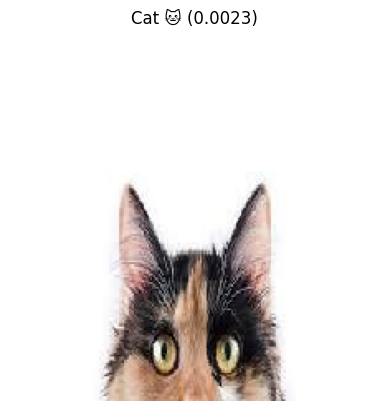

Image: cat_203.jpg
Prediction: Cat 🐱, Confidence: 0.0023

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


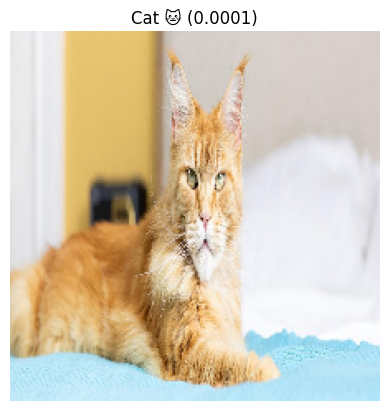

Image: cat_223.jpg
Prediction: Cat 🐱, Confidence: 0.0001

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


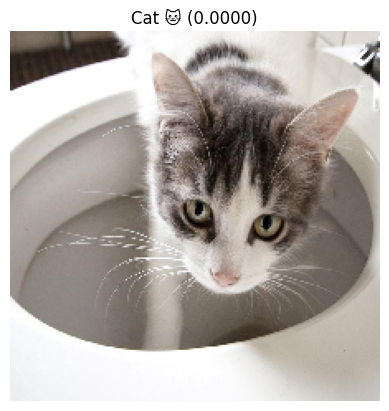

Image: cat_234.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


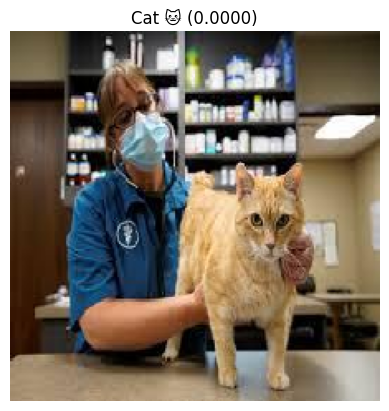

Image: cat_244.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


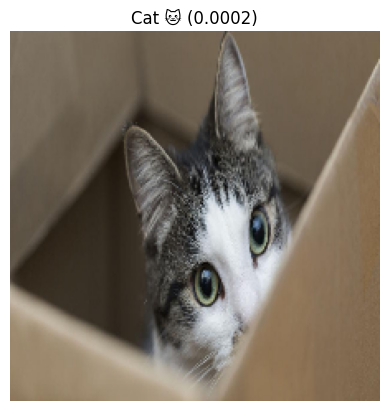

Image: cat_251.jpg
Prediction: Cat 🐱, Confidence: 0.0002

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


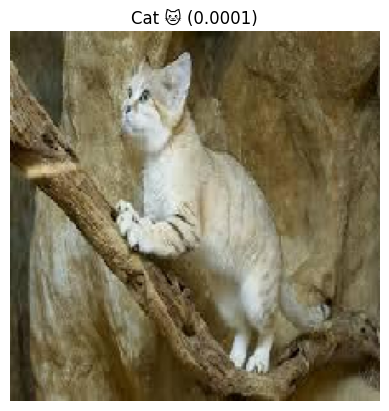

Image: cat_255.jpg
Prediction: Cat 🐱, Confidence: 0.0001

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


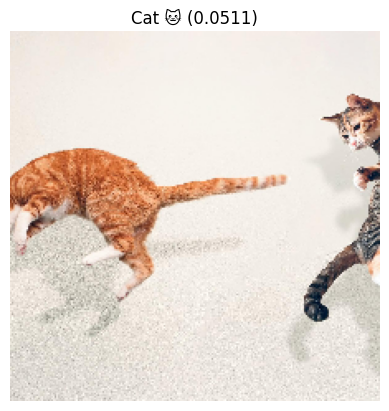

Image: cat_268.jpg
Prediction: Cat 🐱, Confidence: 0.0511

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


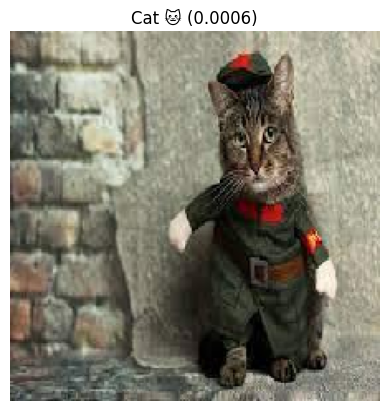

Image: cat_279.jpg
Prediction: Cat 🐱, Confidence: 0.0006

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


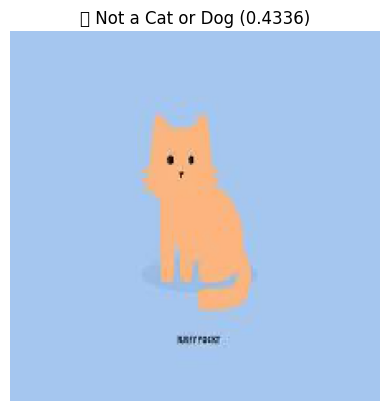

Image: cat_281.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4336

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


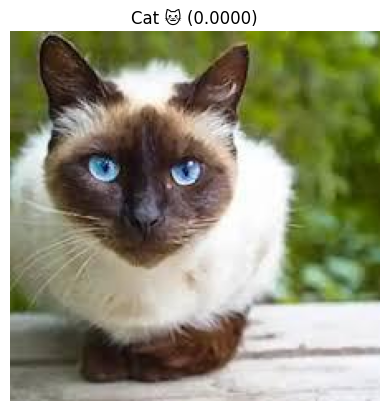

Image: cat_290.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


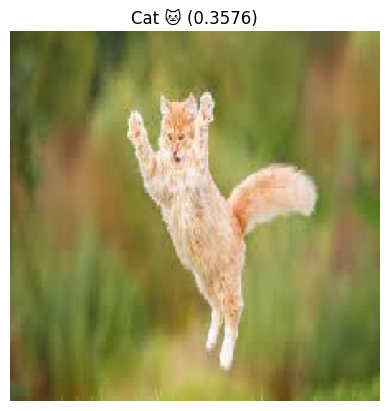

Image: cat_306.jpg
Prediction: Cat 🐱, Confidence: 0.3576

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


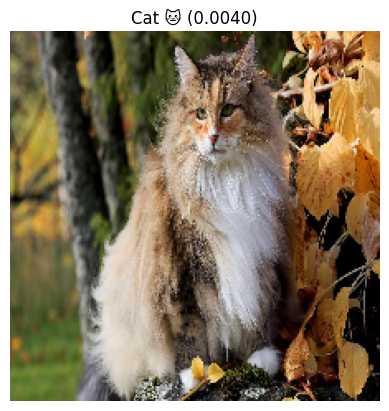

Image: cat_313.jpg
Prediction: Cat 🐱, Confidence: 0.0040

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


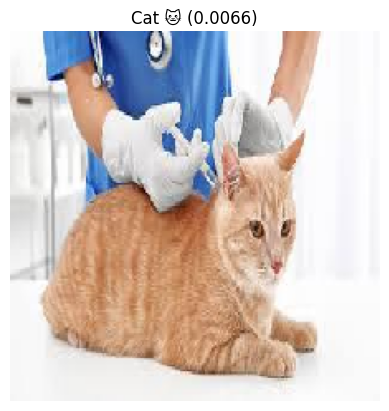

Image: cat_332.jpg
Prediction: Cat 🐱, Confidence: 0.0066

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


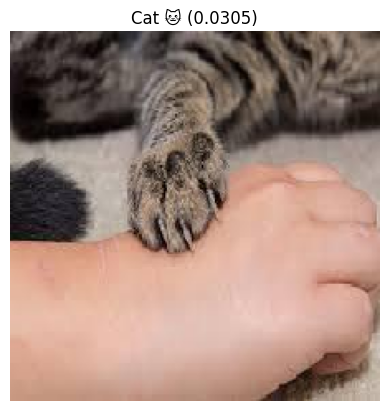

Image: cat_341.jpg
Prediction: Cat 🐱, Confidence: 0.0305

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


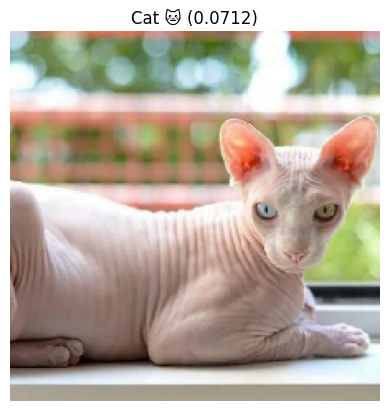

Image: cat_342.jpg
Prediction: Cat 🐱, Confidence: 0.0712

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


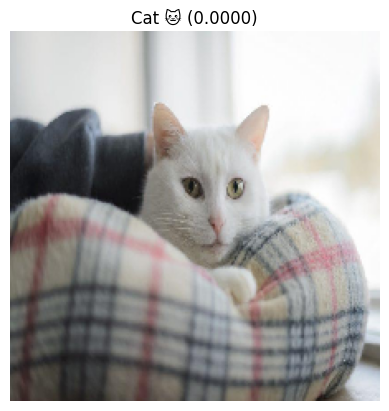

Image: cat_355.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


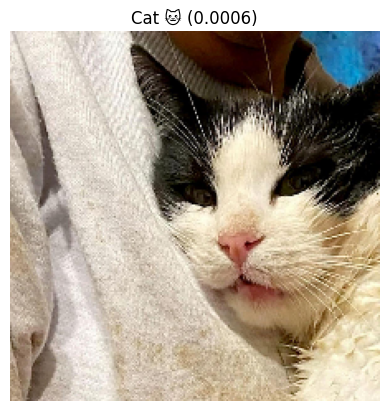

Image: cat_358.jpg
Prediction: Cat 🐱, Confidence: 0.0006

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


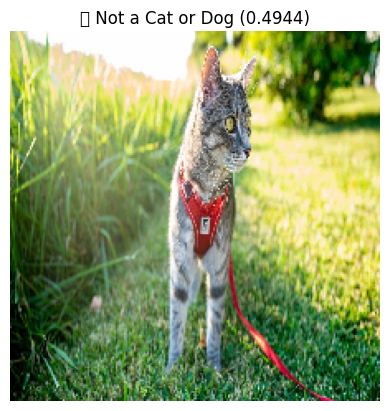

Image: cat_371.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4944

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


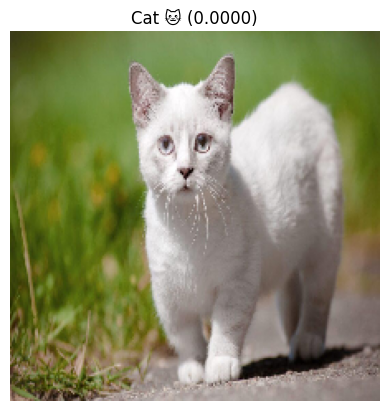

Image: cat_375.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


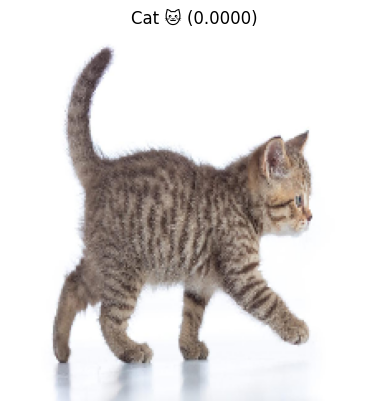

Image: cat_384.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


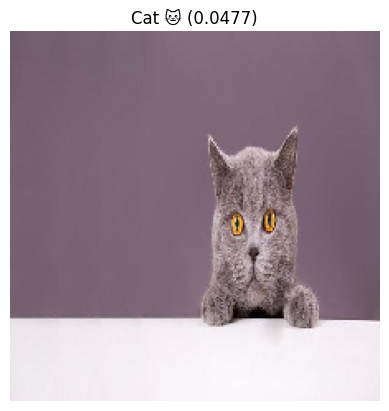

Image: cat_395.jpg
Prediction: Cat 🐱, Confidence: 0.0477

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


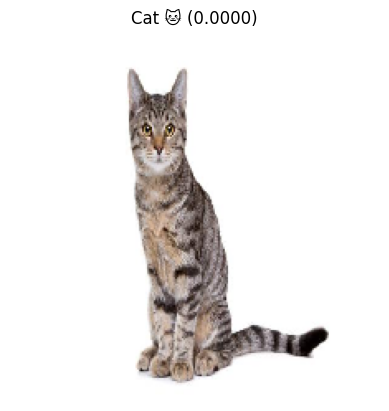

Image: cat_417.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


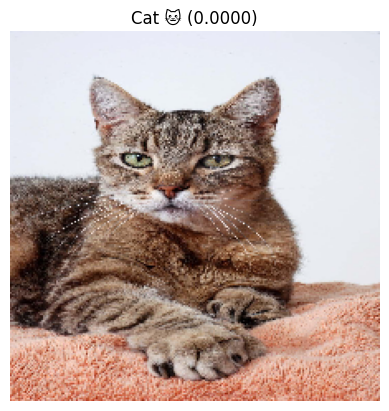

Image: cat_418.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


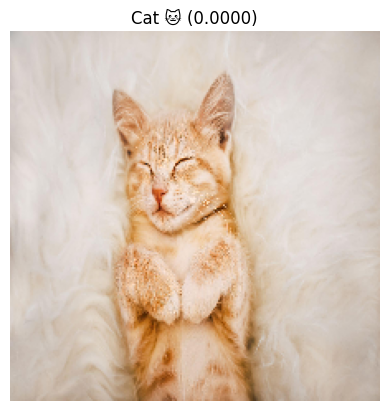

Image: cat_422.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


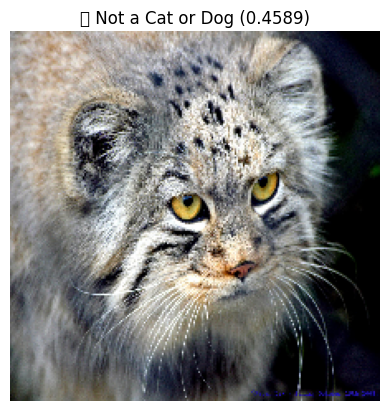

Image: cat_430.jpg
Prediction: ❌ Not a Cat or Dog, Confidence: 0.4589

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


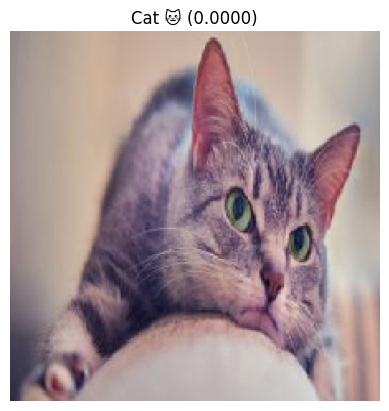

Image: cat_433.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


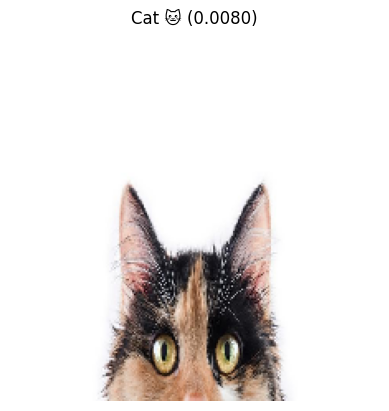

Image: cat_446.jpg
Prediction: Cat 🐱, Confidence: 0.0080

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


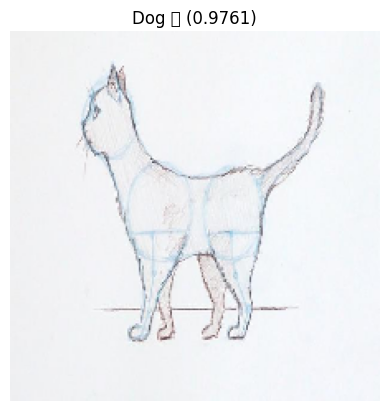

Image: cat_464.jpg
Prediction: Dog 🐶, Confidence: 0.9761

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


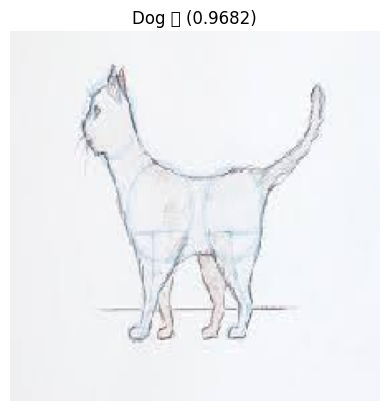

Image: cat_468.jpg
Prediction: Dog 🐶, Confidence: 0.9682

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


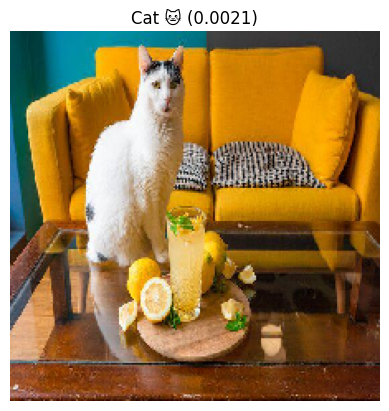

Image: cat_473.jpg
Prediction: Cat 🐱, Confidence: 0.0021

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


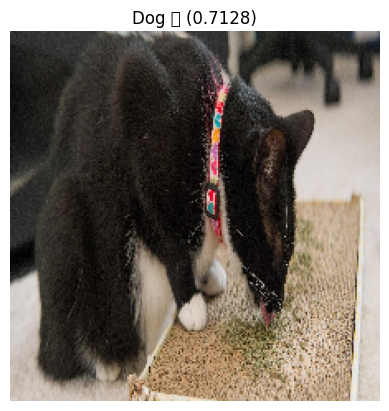

Image: cat_496.jpg
Prediction: Dog 🐶, Confidence: 0.7128

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


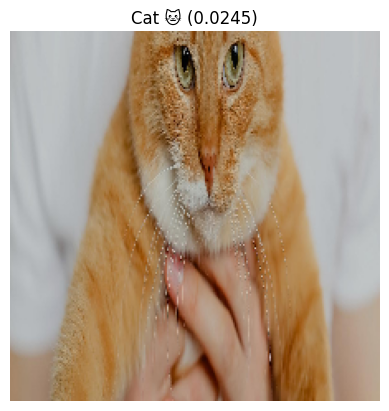

Image: cat_5.jpg
Prediction: Cat 🐱, Confidence: 0.0245

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


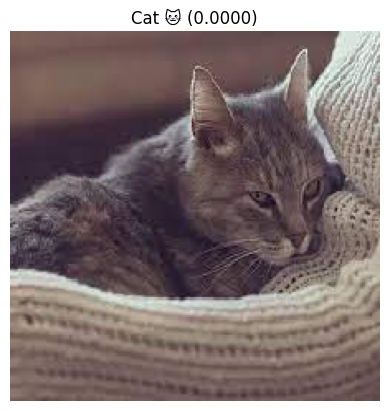

Image: cat_504.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


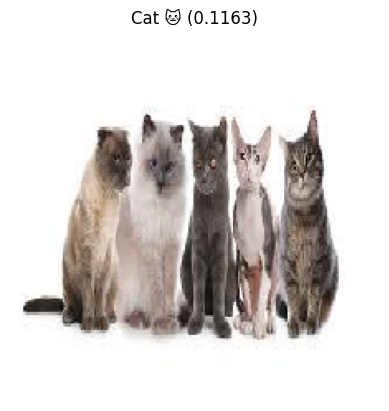

Image: cat_520.jpg
Prediction: Cat 🐱, Confidence: 0.1163

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


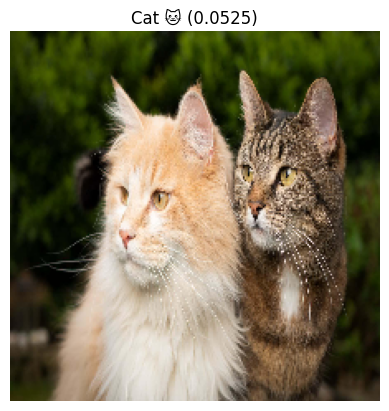

Image: cat_523.jpg
Prediction: Cat 🐱, Confidence: 0.0525

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


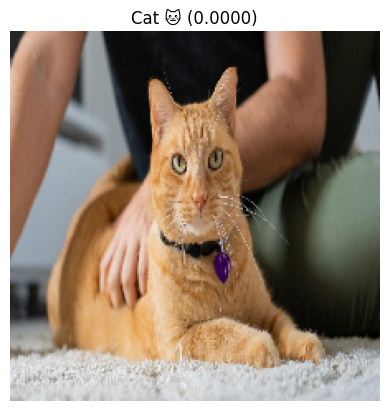

Image: cat_525.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


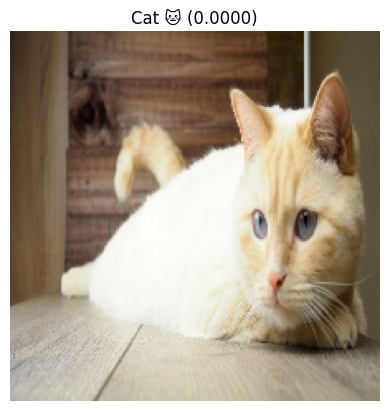

Image: cat_528.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


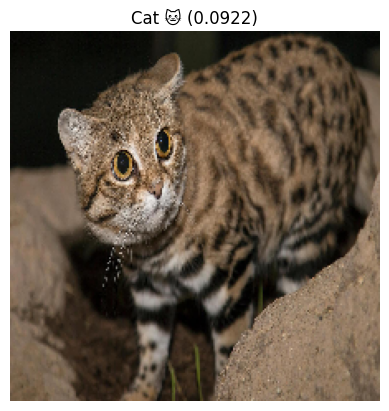

Image: cat_538.jpg
Prediction: Cat 🐱, Confidence: 0.0922

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


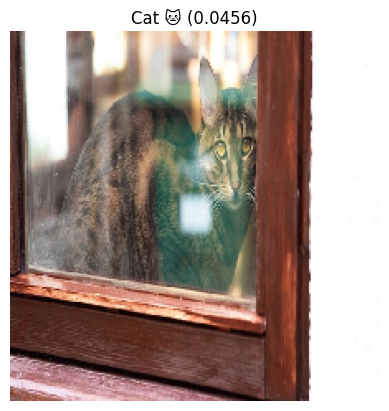

Image: cat_542.jpg
Prediction: Cat 🐱, Confidence: 0.0456

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


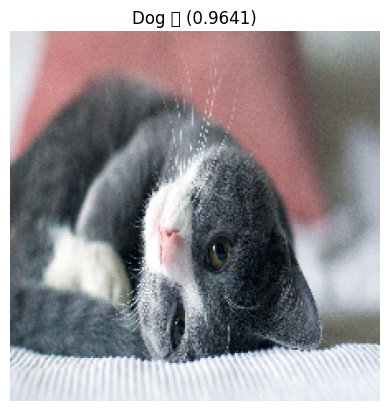

Image: cat_545.jpg
Prediction: Dog 🐶, Confidence: 0.9641

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


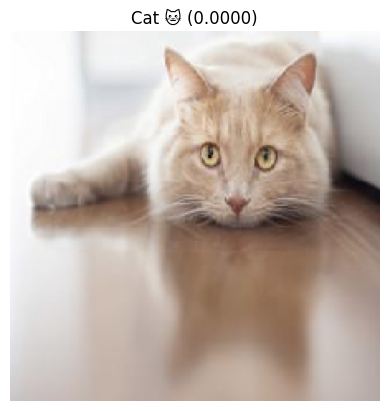

Image: cat_551.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


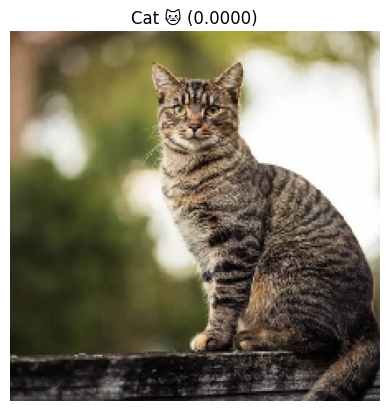

Image: cat_56.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


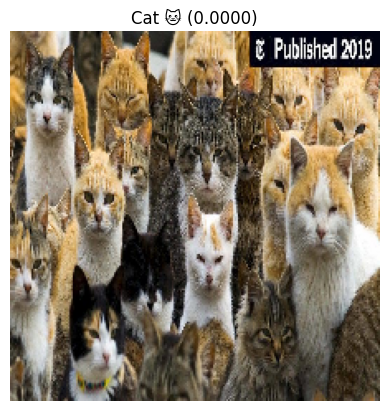

Image: cat_564.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


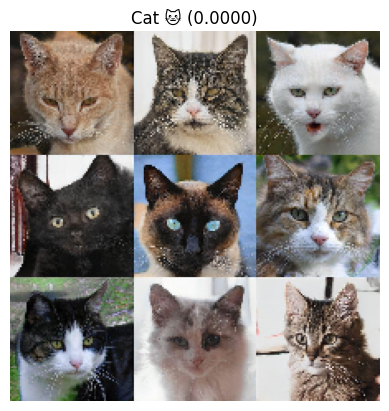

Image: cat_574.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


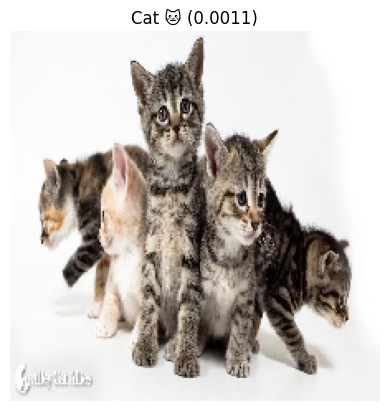

Image: cat_575.jpg
Prediction: Cat 🐱, Confidence: 0.0011

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


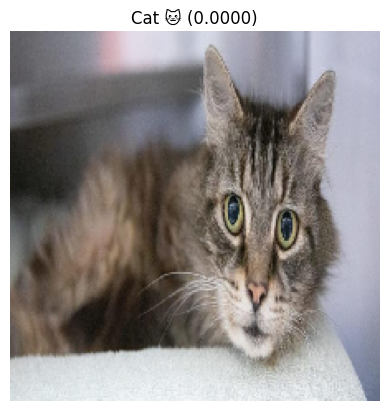

Image: cat_583.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


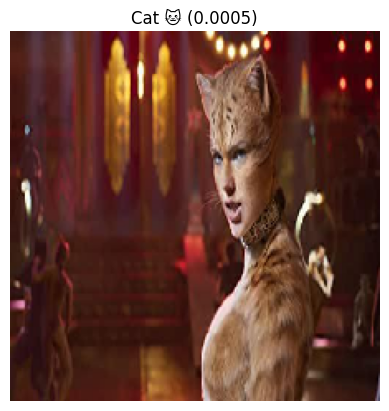

Image: cat_585.jpg
Prediction: Cat 🐱, Confidence: 0.0005

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


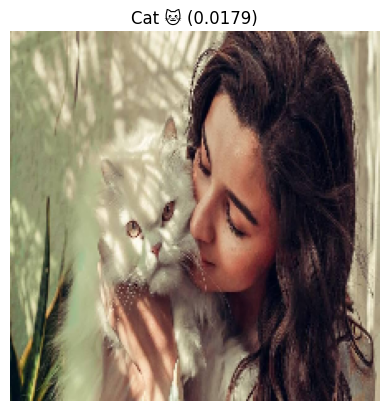

Image: cat_586.jpg
Prediction: Cat 🐱, Confidence: 0.0179

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


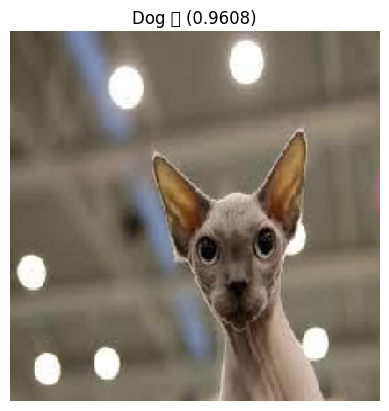

Image: cat_587.jpg
Prediction: Dog 🐶, Confidence: 0.9608

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


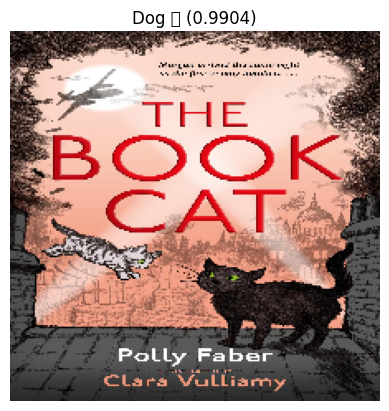

Image: cat_595.jpg
Prediction: Dog 🐶, Confidence: 0.9904

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


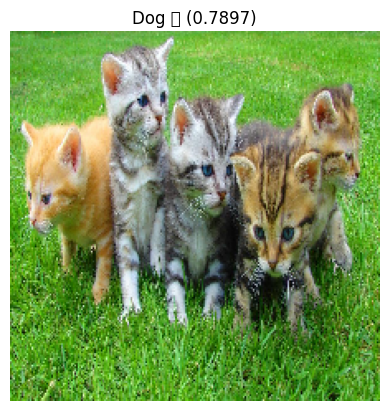

Image: cat_60.jpg
Prediction: Dog 🐶, Confidence: 0.7897

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


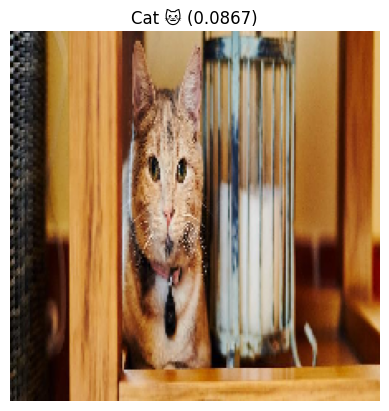

Image: cat_88.jpg
Prediction: Cat 🐱, Confidence: 0.0867

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


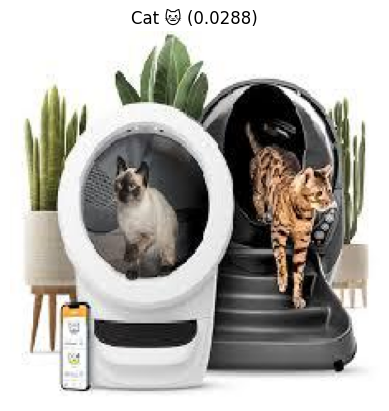

Image: cat_94.jpg
Prediction: Cat 🐱, Confidence: 0.0288

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


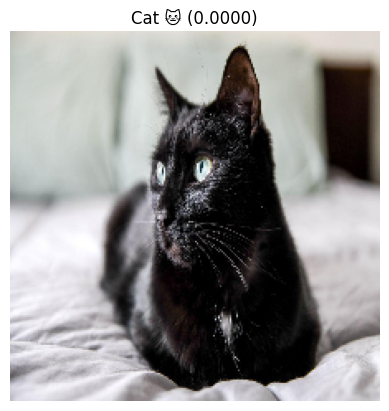

Image: cat_96.jpg
Prediction: Cat 🐱, Confidence: 0.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


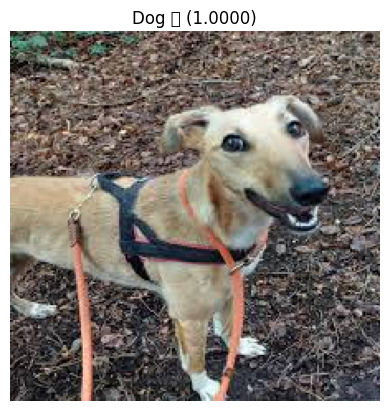

Image: dog_114.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


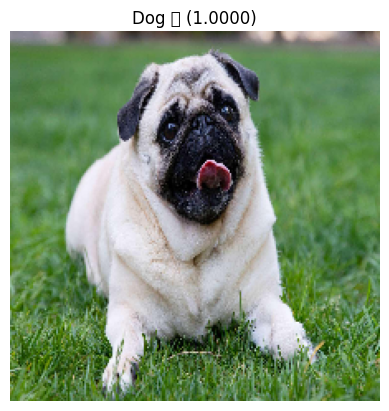

Image: dog_123.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


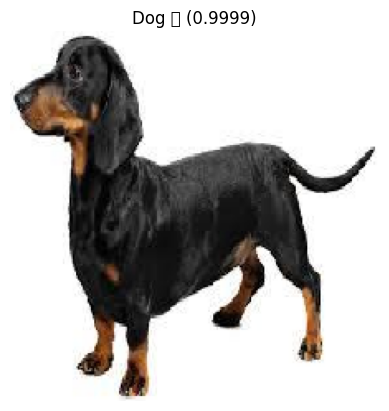

Image: dog_124.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


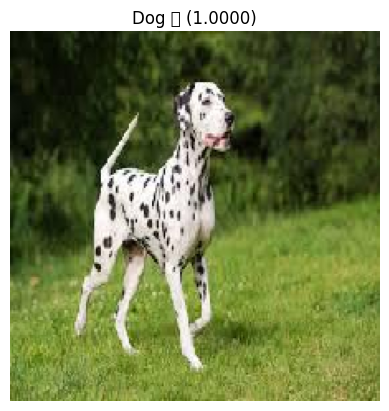

Image: dog_130.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


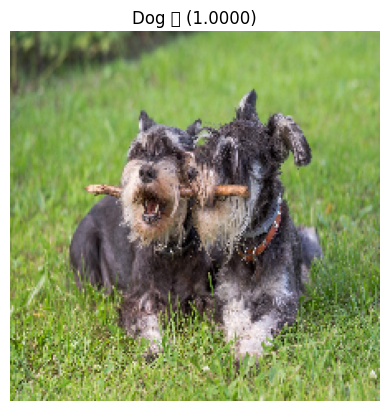

Image: dog_141.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


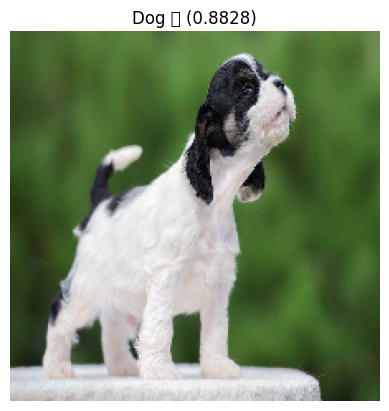

Image: dog_142.jpg
Prediction: Dog 🐶, Confidence: 0.8828

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


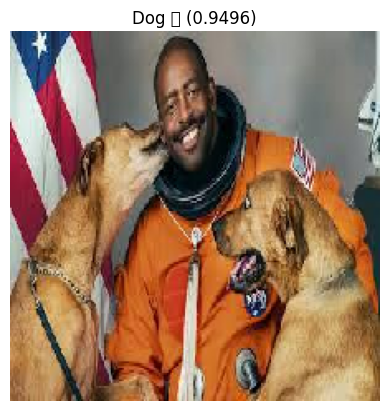

Image: dog_147.jpg
Prediction: Dog 🐶, Confidence: 0.9496

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


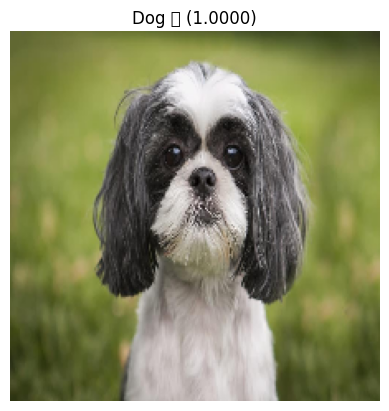

Image: dog_150.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


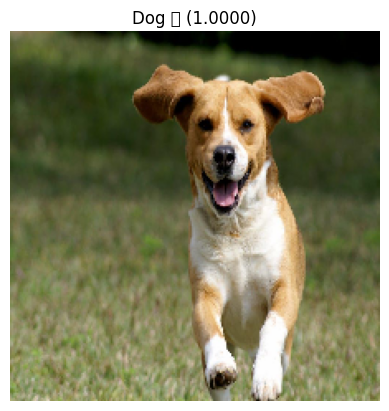

Image: dog_155.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


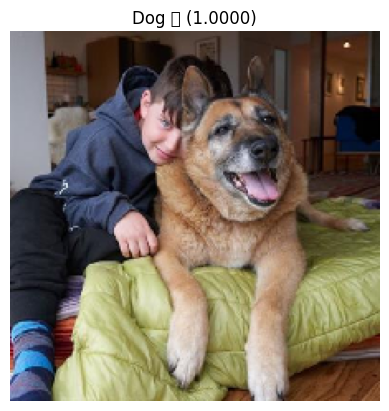

Image: dog_159.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


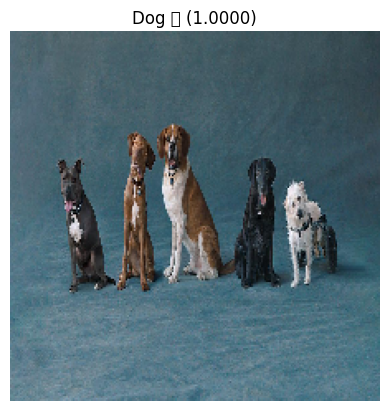

Image: dog_168.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


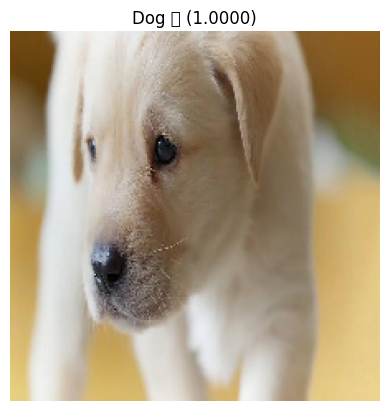

Image: dog_173.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


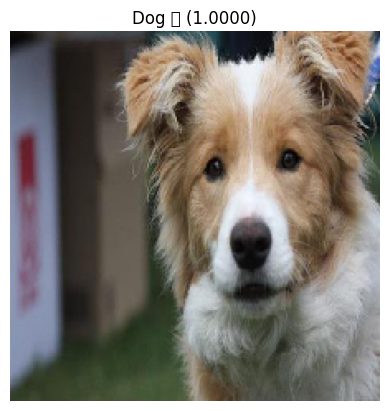

Image: dog_177.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


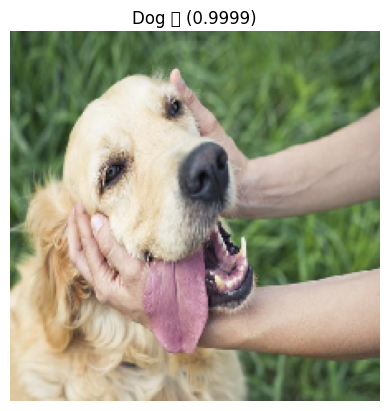

Image: dog_181.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


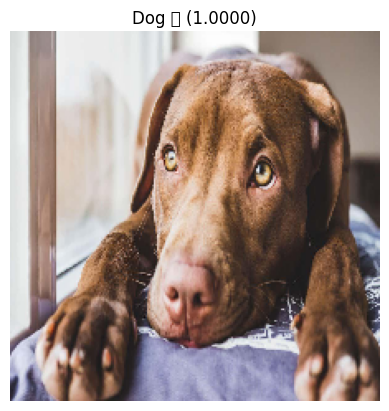

Image: dog_191.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


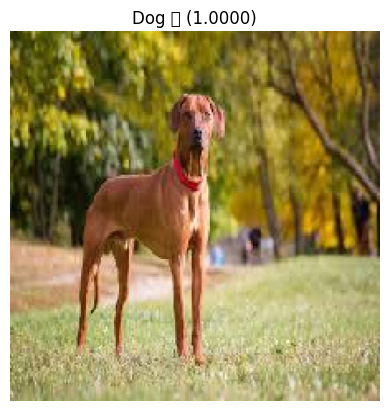

Image: dog_194.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


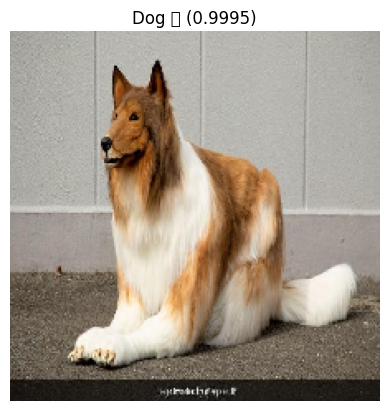

Image: dog_196.jpg
Prediction: Dog 🐶, Confidence: 0.9995

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


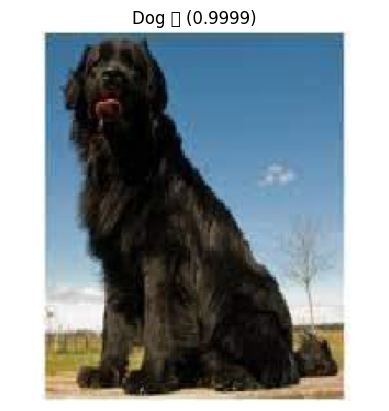

Image: dog_197.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


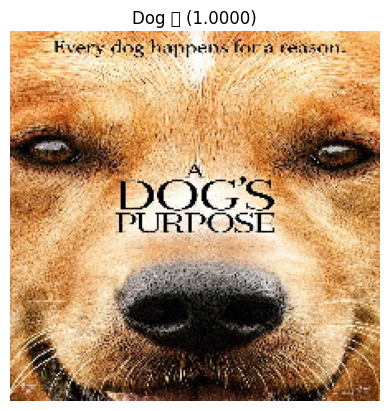

Image: dog_211.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


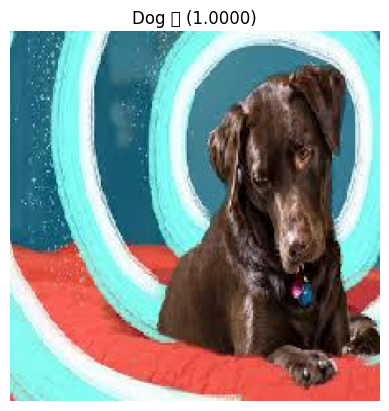

Image: dog_213.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


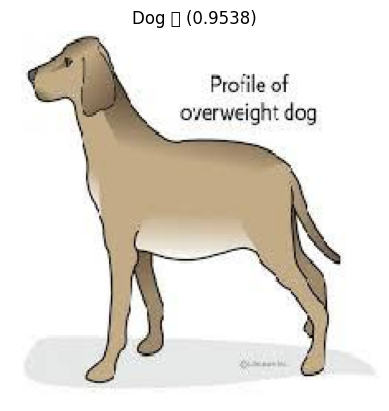

Image: dog_219.jpg
Prediction: Dog 🐶, Confidence: 0.9538

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


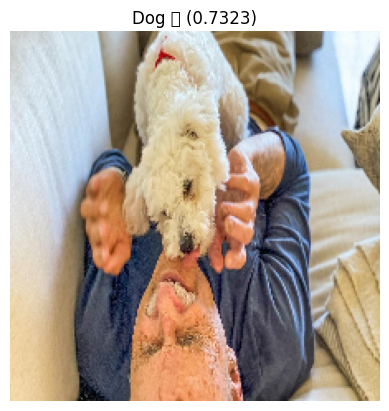

Image: dog_227.jpg
Prediction: Dog 🐶, Confidence: 0.7323

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


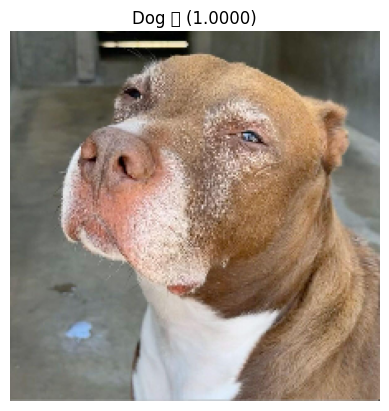

Image: dog_229.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


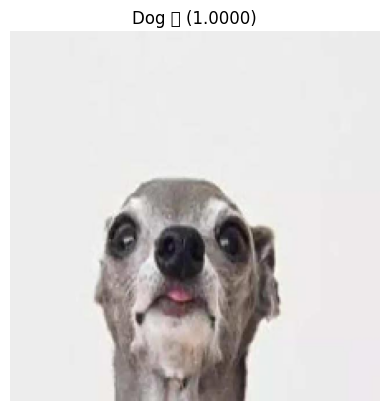

Image: dog_236.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


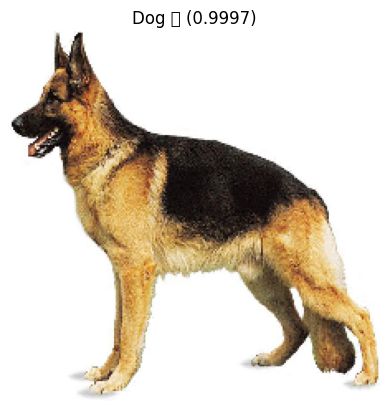

Image: dog_237.jpg
Prediction: Dog 🐶, Confidence: 0.9997

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


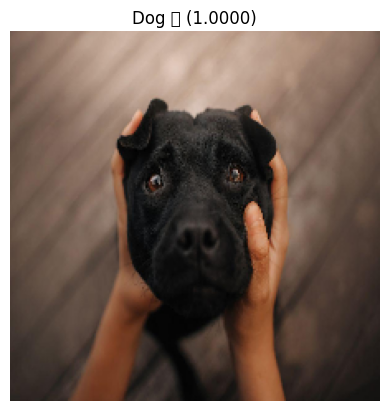

Image: dog_240.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


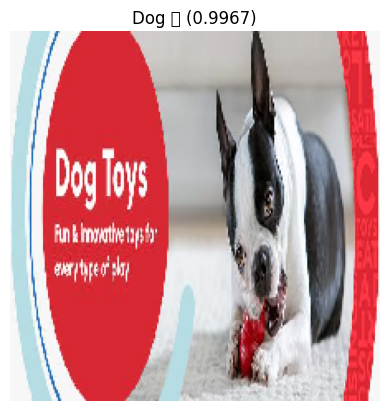

Image: dog_244.jpg
Prediction: Dog 🐶, Confidence: 0.9967

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


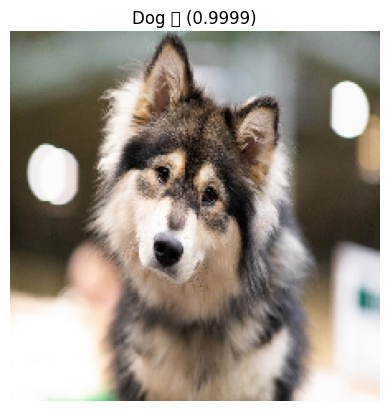

Image: dog_258.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


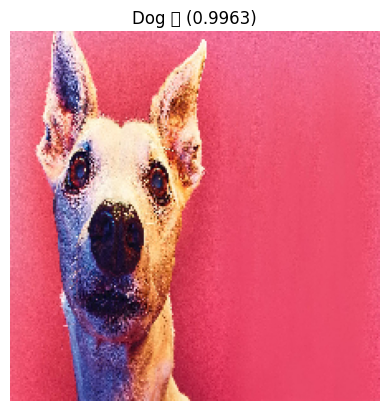

Image: dog_28.jpg
Prediction: Dog 🐶, Confidence: 0.9963

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


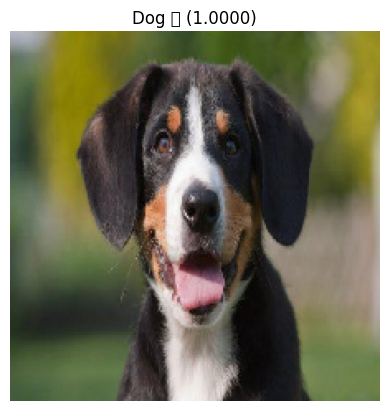

Image: dog_283.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


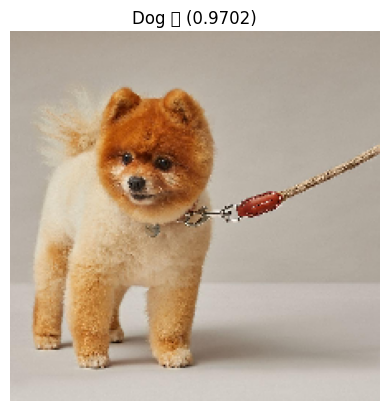

Image: dog_302.jpg
Prediction: Dog 🐶, Confidence: 0.9702

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


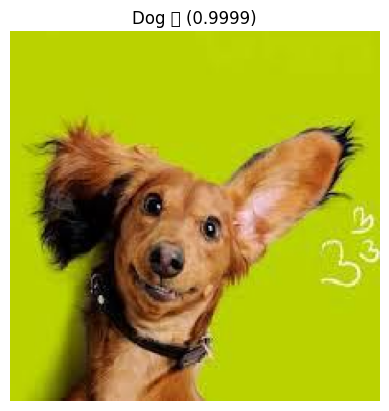

Image: dog_303.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


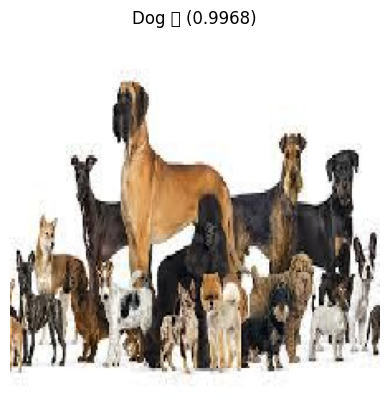

Image: dog_313.jpg
Prediction: Dog 🐶, Confidence: 0.9968

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


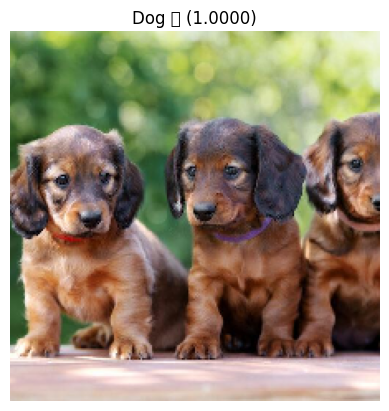

Image: dog_327.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


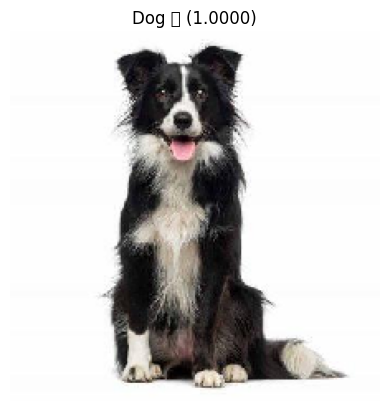

Image: dog_344.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


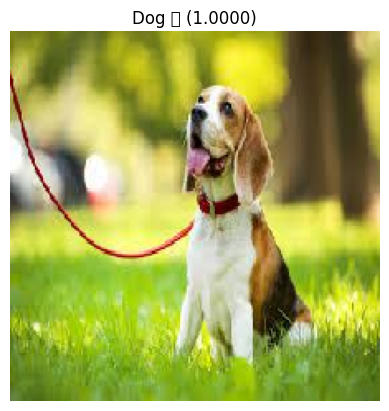

Image: dog_354.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


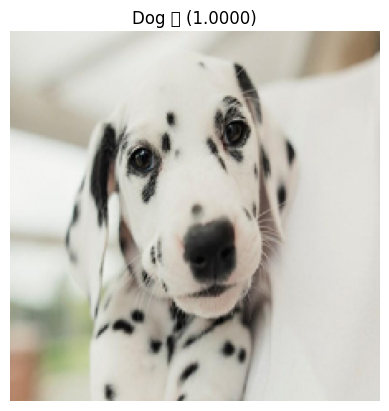

Image: dog_355.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


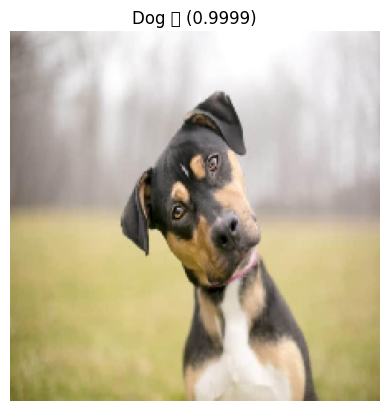

Image: dog_360.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


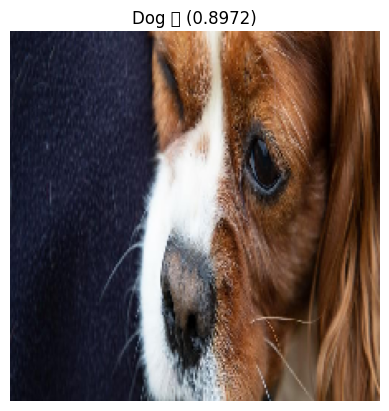

Image: dog_364.jpg
Prediction: Dog 🐶, Confidence: 0.8972

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


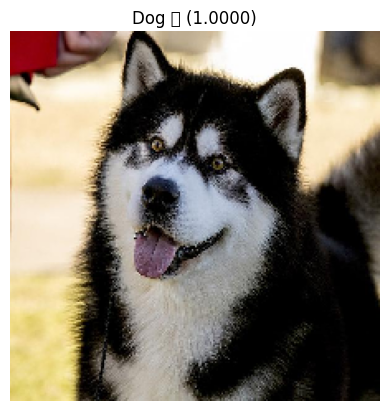

Image: dog_369.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


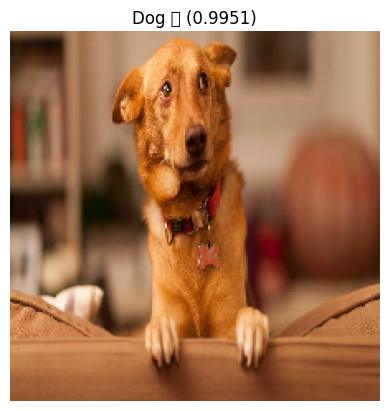

Image: dog_377.jpg
Prediction: Dog 🐶, Confidence: 0.9951

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


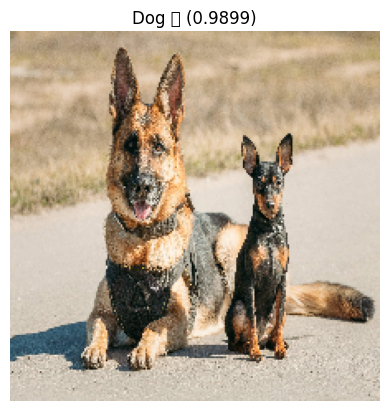

Image: dog_380.jpg
Prediction: Dog 🐶, Confidence: 0.9899

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


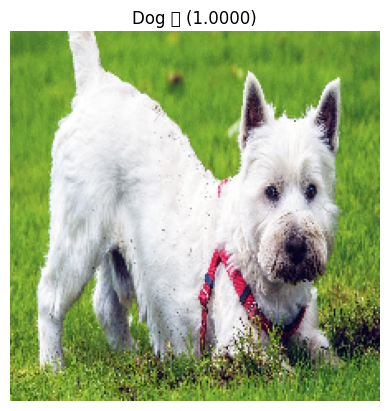

Image: dog_398.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


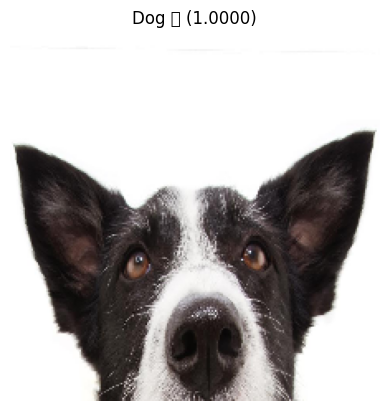

Image: dog_415.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


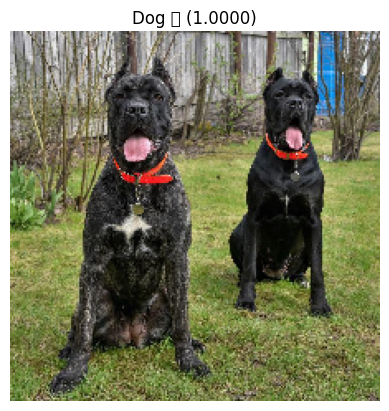

Image: dog_421.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


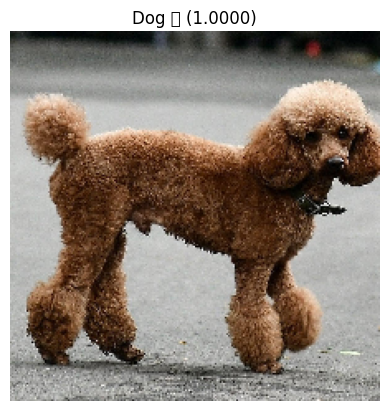

Image: dog_43.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


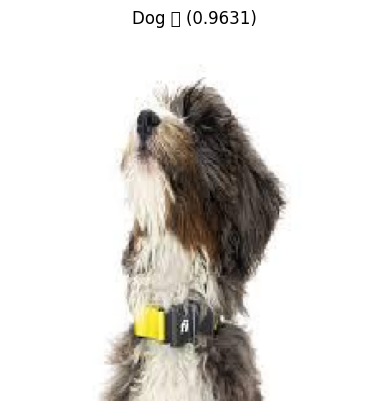

Image: dog_44.jpg
Prediction: Dog 🐶, Confidence: 0.9631

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


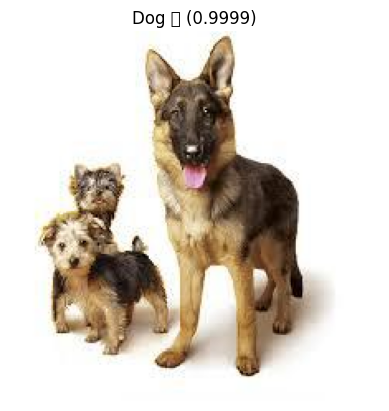

Image: dog_442.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


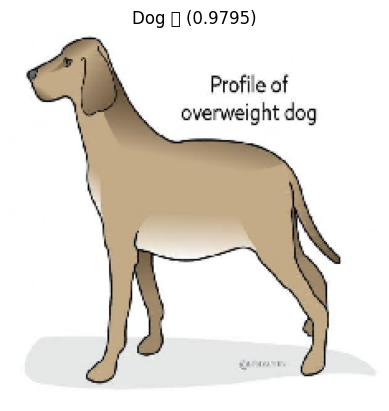

Image: dog_443.jpg
Prediction: Dog 🐶, Confidence: 0.9795

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


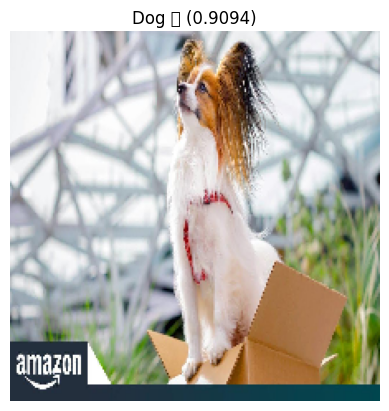

Image: dog_461.jpg
Prediction: Dog 🐶, Confidence: 0.9094

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


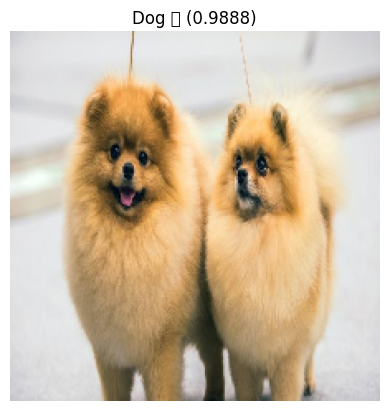

Image: dog_462.jpg
Prediction: Dog 🐶, Confidence: 0.9888

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


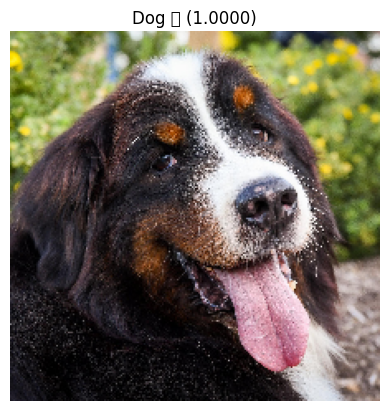

Image: dog_464.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


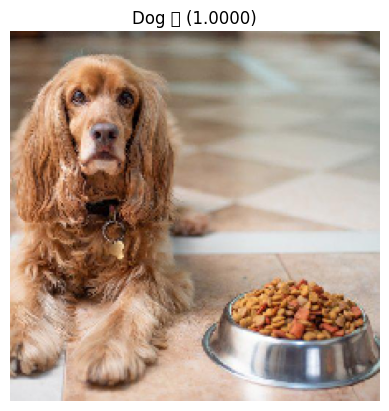

Image: dog_472.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


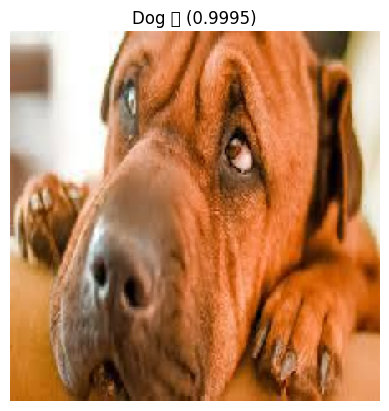

Image: dog_476.jpg
Prediction: Dog 🐶, Confidence: 0.9995

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


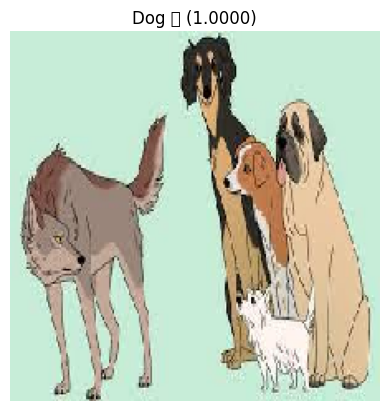

Image: dog_482.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


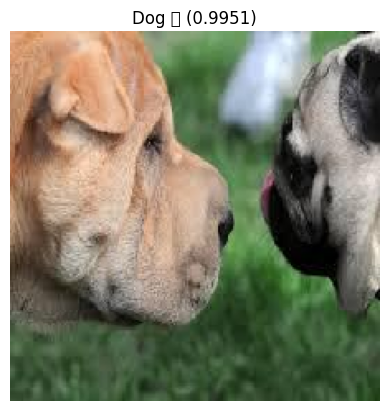

Image: dog_517.jpg
Prediction: Dog 🐶, Confidence: 0.9951

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


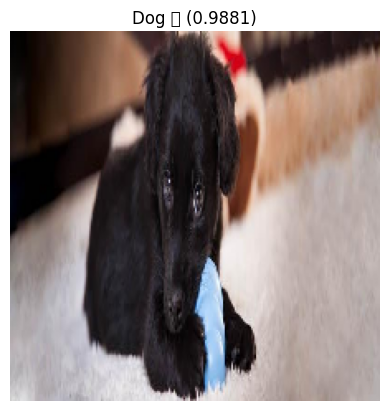

Image: dog_518.jpg
Prediction: Dog 🐶, Confidence: 0.9881

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


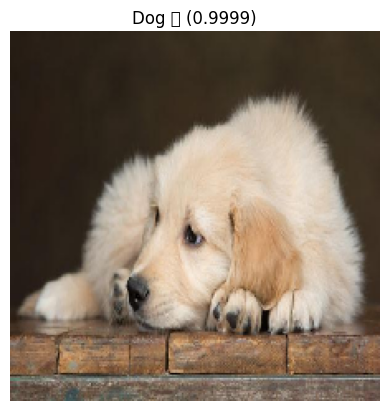

Image: dog_519.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


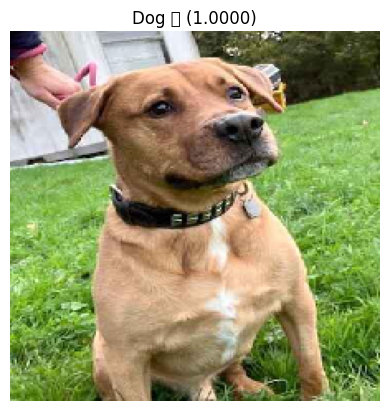

Image: dog_520.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


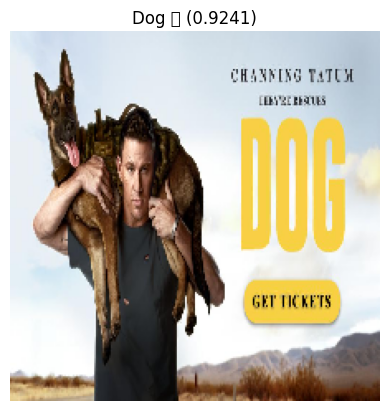

Image: dog_521.jpg
Prediction: Dog 🐶, Confidence: 0.9241

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


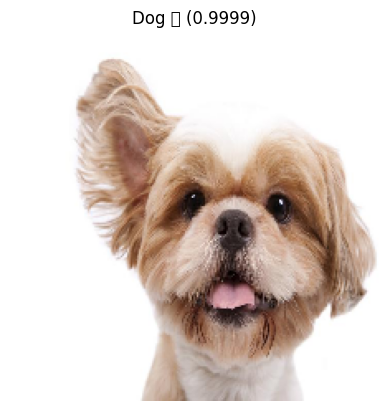

Image: dog_522.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


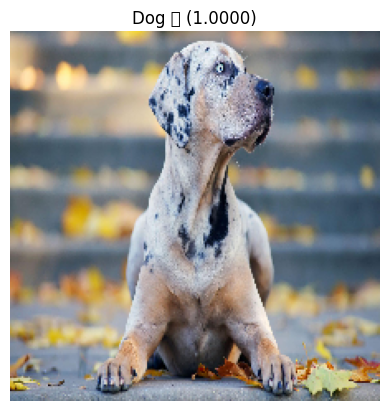

Image: dog_528.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


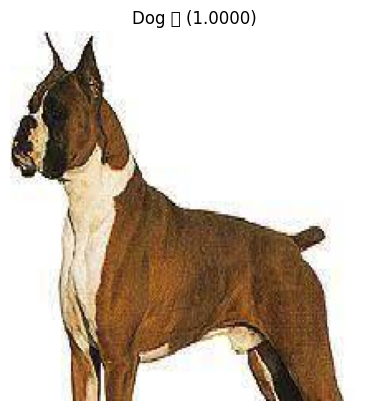

Image: dog_534.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


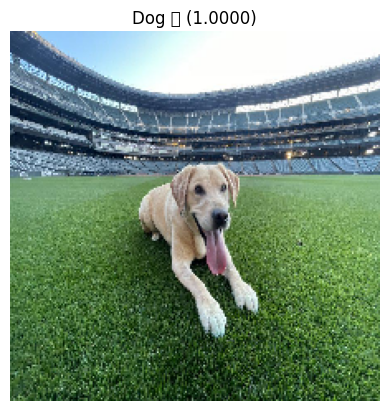

Image: dog_536.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


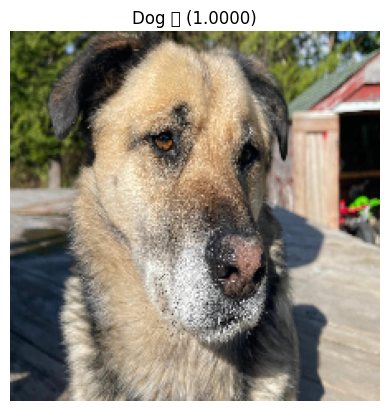

Image: dog_551.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


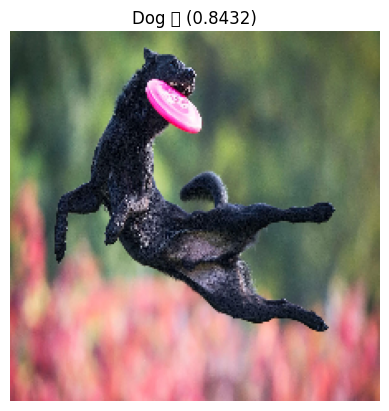

Image: dog_563.jpg
Prediction: Dog 🐶, Confidence: 0.8432

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


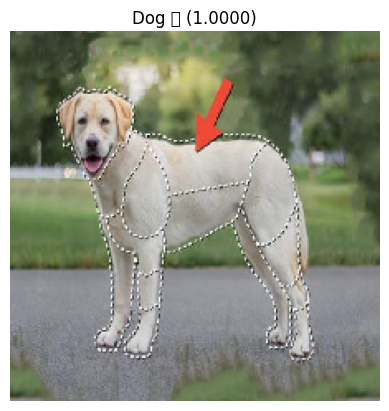

Image: dog_59.jpg
Prediction: Dog 🐶, Confidence: 1.0000

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


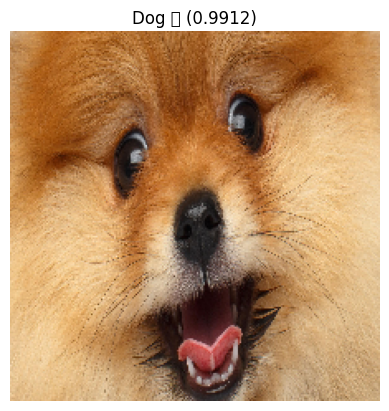

Image: dog_68.jpg
Prediction: Dog 🐶, Confidence: 0.9912

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


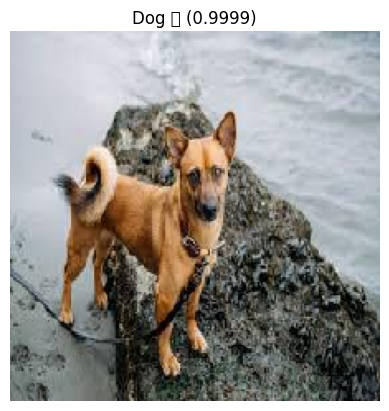

Image: dog_75.jpg
Prediction: Dog 🐶, Confidence: 0.9999

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


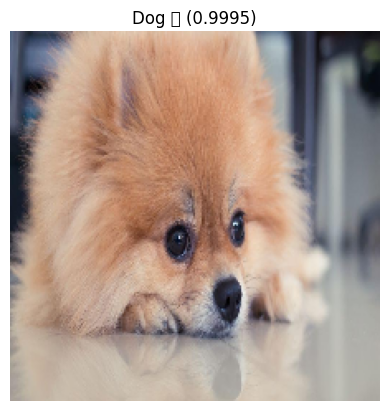

Image: dog_89.jpg
Prediction: Dog 🐶, Confidence: 0.9995



In [18]:
# Load model
model = loaded_model  # Use your loaded model

# Folder with only images
test_folder = "../test"

# Thresholds
cat_threshold = 0.4
dog_threshold = 0.65

print("\n🔍 Running predictions on TEST folder…")

for img_name in os.listdir(test_folder):

    img_path = os.path.join(test_folder, img_name)

    # Skip non-image files
    if not img_path.lower().endswith((".jpg", ".jpeg", ".png", ".bmp", ".webp")):
        continue

    # Load & preprocess image
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)

    # Predict
    prob = model.predict(img_array)[0][0]

    # Classify
    if prob < cat_threshold:
        label = "Cat 🐱"
    elif prob > dog_threshold:
        label = "Dog 🐶"
    else:
        label = "❌ Not a Cat or Dog"

    # Show image
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"{label} ({prob:.4f})")
    plt.show()

    print(f"Image: {img_name}")
    print(f"Prediction: {label}, Confidence: {prob:.4f}\n")